In [1]:
import pandas as pd
import napari
import numpy as np
import tifffile
import scanpy as sc
import skimage.morphology as morphology
import skimage.segmentation as segmentation
import skimage.util as util
import matplotlib
import os
#import squidpy as sq
import plotly.express as px
import os
import gzip
import shutil
import cv2
import matplotlib.pyplot as plt

imagecodecs
leidenalg
pyarrow

In [2]:
viewer = napari.Viewer()

In [3]:
def visualize_gene_by_cell(adata, gene, viewer):
    cmap = matplotlib.colormaps['plasma']
    genes = adata.var.index.values

    values = np.sqrt(adata.raw.X[:,adata.var_names==gene][:,0].toarray()[:,0])
    colors = cmap(values/np.max(values))
    viewer.add_points(adata.obs[['y_centroid', 'x_centroid']].values, name=gene, face_color=colors, size=30, edge_color='black')

In [4]:
def visualize_gene_by_cell_w_boundaries(adata, gene, label_img, viewer):
    values = np.sqrt(adata.raw.X[:,adata.var_names==gene][:,0].toarray()[:,0])
    count_img = util.map_array(label_img, adata.obs['number'].values, values)
    viewer.add_image(count_img, name=gene, colormap='inferno')


In [5]:
def visualize_by_transcript(df, gene, viewer):
    sub_df = df[df['feature_name']==gene]
    viewer.add_points(sub_df[['pix_y', 'pix_x']], size=5, face_color='yellow', name=gene)

# Load data

In [6]:
#data_directory = 'U:/smc/public/SMC/Xenium/pat/output-XETG00063__0010721__Region_1__20231011__183002/'
data_directory = 'U:/smc/public/SMC/Xenium/pat/output-XETG00063__0010721__Region_2__20231011__183002/'

### Load transcripts

In [7]:
#trans_df = pd.read_csv(data_directory + 'transcripts.csv')
trans_df = pd.read_parquet(data_directory + 'transcripts.parquet')

In [8]:
trans_df = trans_df[~trans_df['feature_name'].str.contains('Codeword')]
trans_df = trans_df[~trans_df['feature_name'].str.contains('BLANK')]
trans_df = trans_df[~trans_df['feature_name'].str.contains('NegControl')]

trans_df['pix_x'] = (trans_df['x_location'] * 4.706).astype(int)
trans_df['pix_y'] = (trans_df['y_location'] * 4.706).astype(int)

### Load DAPI Image

In [9]:
full_img = tifffile.imread(data_directory + 'morphology.ome.tif')
orig_img = full_img.max(axis=0)

In [10]:
viewer.add_image(orig_img, name='original image')

<Image layer 'original image' at 0x234543c1c60>

### Load cell data

In [11]:
cell_df = pd.read_csv(data_directory + 'cells.csv')
cell_df['x_centroid'] = cell_df['x_centroid'] * 4.706
cell_df['y_centroid'] = cell_df['y_centroid'] * 4.706

In [12]:
cell_df.set_index('cell_id', inplace=True)

In [13]:
viewer.add_points(cell_df[['y_centroid', 'x_centroid']])

<Points layer 'Points' at 0x234380e9b70>

### Load anndata and merge

In [67]:
adata = sc.read_10x_h5(data_directory + 'cell_feature_matrix.h5')

In [68]:
#adata = sc.read_h5ad('../adata_scvi_10.h5ad')
#adata = adata[adata.obs['sample']=='3'].copy()
cell_df = pd.read_csv(data_directory + 'cells.csv')
cell_df['x_centroid'] = cell_df['x_centroid'] * 4.706
cell_df['y_centroid'] = cell_df['y_centroid'] * 4.706

#cell_df['cell_id'] = cell_df['cell_id'] + '-3'

cell_df.set_index('cell_id', inplace=True)

In [69]:
merged = adata.obs.merge(cell_df, left_index=True, right_index=True, how='left')
#adata.obs['x_centroid'] = merged['x_centroid']
#adata.obs['y_centroid'] = merged['y_centroid']
#adata.obs['transcript_counts'] = merged['transcript_counts']
adata.obs = merged

In [70]:
kmeans_df = pd.read_csv(data_directory + 'analysis/clustering/gene_expression_graphclust/clusters.csv')
kmeans_df.set_index('Barcode', inplace=True)
merged = adata.obs.merge(kmeans_df, left_index=True, right_index=True, how='left').fillna(-1)
adata.obs = merged
adata.obs['Cluster'] = adata.obs['Cluster'].astype(int).astype('category')

c:\Users\smc\AppData\Local\miniforge3\envs\plugin-test\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
c:\Users\smc\AppData\Local\miniforge3\envs\plugin-test\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


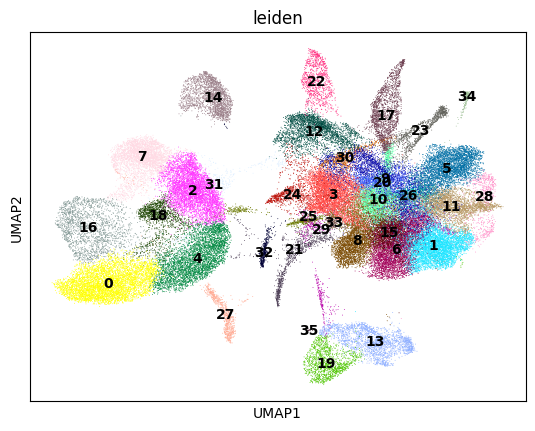

In [71]:
resolution = 1.5
#resolution = 0.5

# Leiden Clustering
######################

# dividing by volume instead
adata.raw = adata.copy()

sc.pp.filter_cells(adata, min_counts=25)
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)
sc.tl.umap(adata)
sc.tl.leiden(adata, resolution=resolution)

# Calculate Leiden Signatures
#########################################df_pos.index = [str(x) for x in list(range(df_pos.shape[0]))]
ser_counts = adata.obs['leiden'].value_counts()
ser_counts.name = 'cell counts'
meta_leiden = pd.DataFrame(ser_counts)

cat_name = 'leiden'
sig_leiden = pd.DataFrame(columns=adata.var_names, index=adata.obs[cat_name].cat.categories)                                                                                                 
for clust in adata.obs[cat_name].cat.categories: 
    sig_leiden.loc[clust] = adata[adata.obs[cat_name].isin([clust]),:].X.mean(0)
sig_leiden = sig_leiden.transpose()
leiden_clusters = ['Leiden-' + str(x) for x in sig_leiden.columns.tolist()]
sig_leiden.columns = leiden_clusters
meta_leiden.index = sig_leiden.columns.tolist()
meta_leiden['leiden'] = pd.Series(meta_leiden.index.tolist(), index=meta_leiden.index.tolist())

# generate colors for categories by plotting
sc.pl.umap(adata, color="leiden", legend_loc='on data', save='leiden.pdf')
cats = adata.obs['leiden'].cat.categories.tolist()
colors = list(adata.uns['leiden_colors'])
cat_colors = dict(zip(cats, colors))  

# colors for clustergrammer2
ser_color = pd.Series(cat_colors)
ser_color.name = 'color'
df_colors = pd.DataFrame(ser_color)
df_colors.index = ['Leiden-' + str(x) for x in df_colors.index.tolist()]

df_colors.loc[''] = 'white'


Let's try loading their parquet files instead of this silly expanding

In [72]:
adata.obs['number'] = np.arange(1, adata.obs.shape[0]+1)

In [73]:
bounds_df = pd.read_parquet(data_directory + 'cell_boundaries.parquet')
bounds_df['vertex_x'] = bounds_df['vertex_x'] * 4.706
bounds_df['vertex_y'] = bounds_df['vertex_y'] * 4.706
bounds_df = bounds_df.merge(adata.obs, left_on='cell_id', right_index=True)

In [74]:
label_img = np.zeros((orig_img.shape[0], orig_img.shape[1]), dtype=np.int32)

In [75]:
bdf = bounds_df[['cell_id', 'vertex_x', 'vertex_y', 'leiden', 'number', 'Cluster']].copy()
bdf['vertex_x'] = bdf['vertex_x'].astype(int)
bdf['vertex_y'] = bdf['vertex_y'].astype(int)
bdf['leiden'] = bdf['leiden'].astype(int)
bdf['Cluster'] = bdf['Cluster'].astype(int)
bdf['number'] = bdf['number'].astype(int)

In [76]:
grouped = bdf.groupby('cell_id')

In [77]:
def myfunc(x, label_img):
    vertices = x[['vertex_x', 'vertex_y']].to_numpy()
    #cv2.fillPoly(label_img, [vertices], int(x.iloc[0]['leiden'])+1)
    cv2.fillPoly(label_img, [vertices], int(x.iloc[0]['number']))

In [78]:
grouped.apply(myfunc, label_img)

""


In [79]:
viewer.add_labels(label_img)

<Labels layer 'label_img' at 0x2367f9ae200>

In [80]:
leiden_img = util.map_array(label_img.astype(int), adata.obs['number'].values, 1+(adata.obs['leiden'].astype(int).values))
viewer.add_labels(leiden_img)

cluster_img = util.map_array(label_img.astype(int), adata.obs['number'].values, 1+(adata.obs['Cluster'].astype(int).values))
viewer.add_labels(cluster_img)

<Labels layer 'cluster_img' at 0x2368dd8f280>

In [81]:
genes = adata.var.index.values
gene = genes[150]
visualize_gene_by_cell(adata, gene, viewer)
visualize_by_transcript(trans_df, gene, viewer)
visualize_gene_by_cell_w_boundaries(adata, gene, label_img, viewer)

The silly expanding way

nucleii = np.zeros(viewer.layers[0].data.shape)

nucleii[adata.obs['y_centroid'].values.astype(int), adata.obs['x_centroid'].values.astype(int)] = np.arange(1, adata.obs.shape[0]+1)

if os.path.exists('nucleii.tif'):
    expanded = tifffile.imread('nucleii.tif')
else:
    expanded = segmentation.expand_labels(nucleii, 100)
    tifffile.imwrite('nucleii.tif', expanded)



adata.obs['number'] = np.arange(1, adata.obs.shape[0]+1)

leiden_img = util.map_array(expanded.astype(int), adata.obs['number'].values, 1+(adata.obs['leiden'].astype(int).values))
viewer.add_labels(leiden_img)

count_img = util.map_array(expanded.astype(int), adata.obs['number'].values, (adata.obs['transcript_counts'].astype(int).values))
viewer.add_image(count_img)

# Squidpy Visualization

In [33]:
adata.obs

,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,Cluster,n_counts,leiden,number
cell_id,,,,,,,,,,,,,,
aaaaklid-1,7922.647510,4069.926539,48,0,0,0,0,48,98.079379,10.431094,2,48.0,0,1
aaablnij-1,7926.602112,3996.840498,96,0,0,0,0,96,176.470631,35.899220,4,96.0,0,2
aaabojcg-1,8651.556472,4061.359861,294,0,0,0,0,294,131.901411,98.756722,8,294.0,18,3
aaacblip-1,7927.902696,4034.071150,124,0,0,0,0,124,183.424694,37.840939,4,124.0,0,4
aaacheid-1,7987.312500,4087.356892,108,0,0,0,0,108,52.471564,36.847501,2,108.0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
oiifooda-1,4080.313115,12385.828939,96,0,0,0,0,96,52.336096,11.560000,13,96.0,19,53679
oiiigbgj-1,4222.590052,12376.792638,144,0,0,0,0,144,90.718910,49.491252,13,144.0,19,53680
oiiipnen-1,4137.604012,12268.298428,153,0,0,0,0,153,195.165320,31.564220,18,153.0,16,53681


In [34]:
adata.obsm['spatial'] = adata.obs[['x_centroid','y_centroid']] .to_numpy()

spatial_key = "spatial"
library_id = "0"
adata.uns[spatial_key] = {library_id: {}}
adata.uns[spatial_key][library_id]["images"] = {}
adata.uns[spatial_key][library_id]["images"] = {"hires": orig_img}
adata.uns[spatial_key][library_id]["scalefactors"] = {"tissue_hires_scalef": 1, "spot_diameter_fullres": 40.0}

In [35]:
import squidpy as sq

In [36]:
img_container = sq.im.ImageContainer(orig_img)
sq_viewer = img_container.interactive(adata)

c:\Users\smc\AppData\Local\miniforge3\envs\napari\lib\site-packages\squidpy\im\_container.py:1117: DeprecationWarning: Call to deprecated function __init__ (The squidpy napari plugin is deprecated, please use https://github.com/scverse/napari-spatialdata).
  return Interactive(  # type: ignore[no-any-return]


ImportError: Unable to import the interactive viewer. Reason `No module named 'deprecated'`.

# Comparing to other clustering methods

In [32]:
import plotly.express as px

### Squidpy

Add squidpy results from WashU to adata

In [65]:
squidpy_df = pd.read_csv('Squidpy_Analysis/Xenium_Explorer_Squidpy_Clusters.csv')
adata.obs['group'] = adata.obs.merge(squidpy_df, left_index=True, right_on='cell_id')['group'].values
adata.obs['group'] = adata.obs['group'].astype('category')

Plot our UMAP with the WashU squidpy clusters colored

In [80]:
px.scatter(adata.obs, x=adata.obsm['X_umap'][:,0], y=adata.obsm['X_umap'][:,1], color='leiden', height=800)

c:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [76]:
squidpy_img = util.map_array(expanded.astype(int), adata.obs['number'].values, 1+(adata.obs['group'].astype(int).values))
viewer.add_labels(squidpy_img)

<Labels layer 'squidpy_img' at 0x1f66f26f430>

### Seurat

Add Seurat clusters to adata

In [68]:
seurat_df = pd.read_csv('Seurat_Cluster_Analysis_0.3_Resolution/Xenium_Explorer_Seurat_Clusters.csv').rename(columns={'group':'Seurat'})
adata.obs['Seurat'] = adata.obs.merge(seurat_df, left_index=True, right_on='cell_id')['Seurat'].values
adata.obs['Seurat'] = adata.obs['Seurat'].astype('category')

In [69]:
px.scatter(adata.obs, x=adata.obsm['X_umap'][:,0], y=adata.obsm['X_umap'][:,1], color='Seurat', height=800)

c:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [77]:
seurat_img = util.map_array(expanded.astype(int), adata.obs['number'].values, 1+(adata.obs['Seurat'].astype(int).values))
viewer.add_labels(seurat_img)

<Labels layer 'seurat_img' at 0x1f69e477460>

### 10X kmeans clustering

Add kmeans data to the adata object

In [71]:
kmeans_df = pd.read_csv('analysis/clustering/gene_expression_graphclust/clusters.csv')
adata.obs['Cluster'] = adata.obs.merge(kmeans_df, left_index=True, right_on='Barcode')['Cluster'].values
adata.obs['Cluster'] = adata.obs['Cluster'].astype('category')

In [72]:
px.scatter(adata.obs, x=adata.obsm['X_umap'][:,0], y=adata.obsm['X_umap'][:,1], color='Cluster', height=800)

c:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [78]:
kmeans_img = util.map_array(expanded.astype(int), adata.obs['number'].values, 1+(adata.obs['Cluster'].astype(int).values))
viewer.add_labels(kmeans_img)

<Labels layer 'kmeans_img' at 0x1f698b0f910>

In [79]:
agged = adata.obs.groupby(['leiden', 'Seurat']).size().reset_index().rename(columns={0:'ct'})
px.bar(agged, x='Seurat', y='ct', color='leiden')

C:\Users\smc\AppData\Local\Temp\ipykernel_13380\4106956561.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

c:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [45]:
agged = adata.obs.groupby(['leiden', 'Cluster']).size().reset_index().rename(columns={0:'ct'})
px.bar(agged, x='leiden', y='ct', color='Cluster')

C:\Users\smc\AppData\Local\Temp\ipykernel_13380\3546766545.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

c:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



# Looking at specific clusters

In [82]:
stack = []
for cluster in range(0,np.max(leiden_img)):
    stack.append((leiden_img==(cluster+1)).astype(int)*5)
stack = np.array(stack)

In [87]:
tifffile.imwrite('leiden.tif', stack.astype(np.ubyte), imagej=True, metadata={'axes':'ZYX'})

In [17]:
genes = adata.var.index.values

gene = 'Chat'
#gene = np.random.choice(genes, 1)[0]
#values = np.sqrt(adata.raw.X[:,adata.var_names==gene][:,0].toarray()[:,0])
values = adata.raw.X[:,adata.var_names==gene][:,0].toarray()[:,0]

gene_img = util.map_array(expanded.astype(int), adata.obs['number'].values, values)

#viewer.add_image(gene_img, name=gene, colormap='inferno', contrast_limits=[0,40])

In [18]:
interesting = ['Calb2', 'Chat', 'Fos', 'Penk', 'Pthlh']

In [19]:
for gene in interesting:
    values = adata.raw.X[:,adata.var_names==gene][:,0].toarray()[:,0]
    gene_img = util.map_array(expanded.astype(int), adata.obs['number'].values, values)
    viewer.add_image(gene_img, name=gene, colormap='inferno', contrast_limits=[0,40])

C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning: data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is currently in 2D mode.
  warnings.warn(
C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning: data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is currently in 2D mode.
  warnings.warn(
C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning: data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is currently in 2D mode.
  warnings.warn(
C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning: data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is current

In [20]:
import plotly.express as px

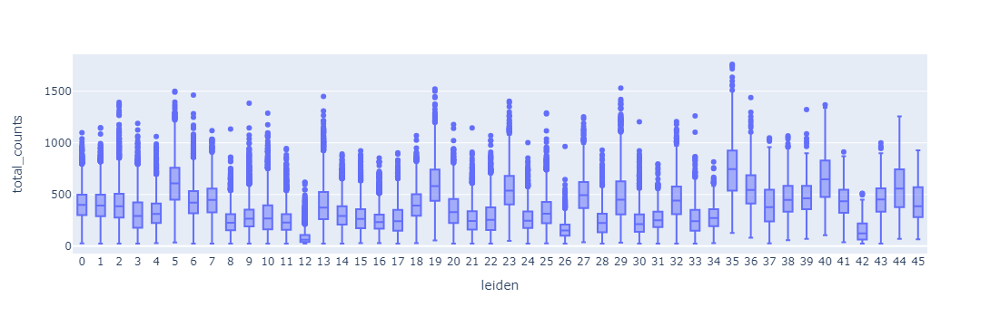

In [21]:
px.box(adata.obs, x='leiden', y='total_counts', category_orders={'leiden':np.arange(0, np.max(adata.obs['leiden'].astype(int)))})

In [22]:
adata.obs['umap_0'] = adata.obsm['X_umap'][:,0]
adata.obs['umap_1'] = adata.obsm['X_umap'][:,1]

C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



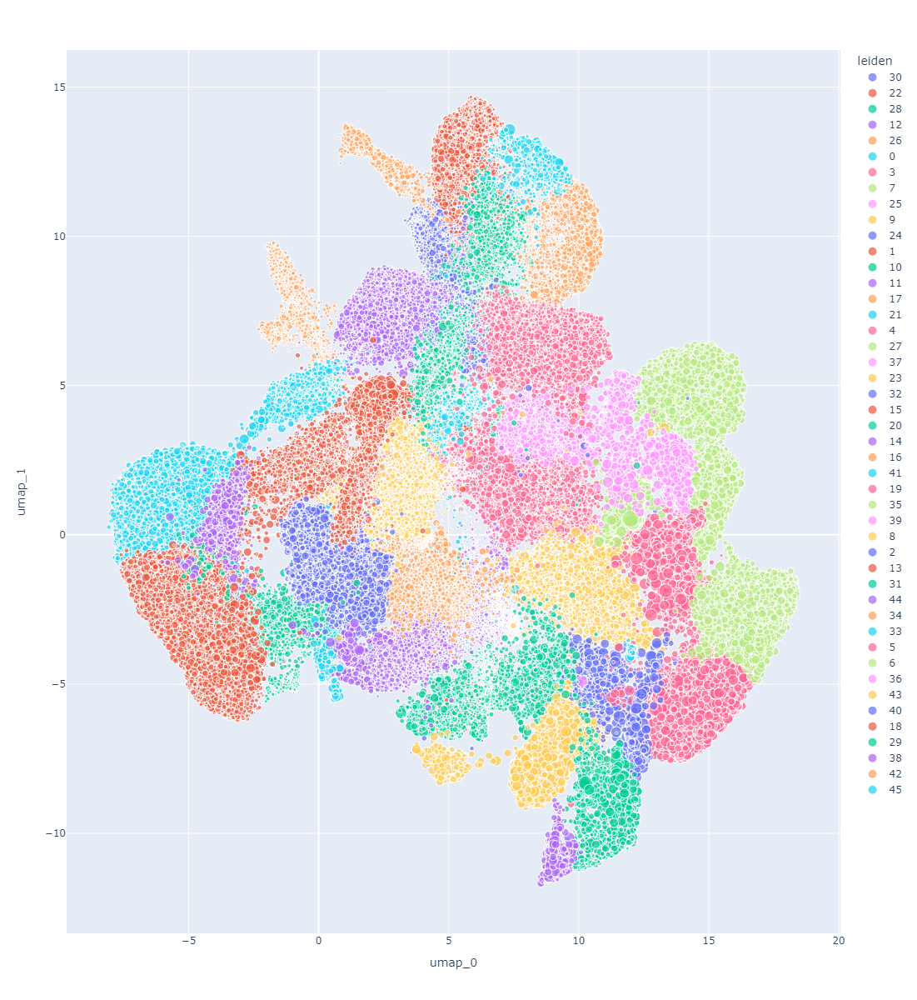

C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning:

data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is currently in 2D mode.

C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning:

data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is currently in 2D mode.

C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning:

data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is currently in 2D mode.

C:\Users\smc\Miniconda3\envs\sccp\lib\site-packages\napari\_vispy\layers\image.py:274: UserWarning:

data shape (37448, 45447) exceeds GL_MAX_TEXTURE_SIZE 32768 in at least one axis and will be downsampled. Rendering is currently in 2D mode.

C:\Users\smc\Miniconda3\envs

In [23]:
px.scatter(adata.obs, x='umap_0', y='umap_1', size=(adata.obs['total_counts'])**1.5, color='leiden', height=1200)

In [26]:
np.max(leiden_img)

46